# Annotations using clustering for cells for liver_s0

In [1]:
slide_id = "liver_s0"

In [2]:
import pandas as pd
import scanpy as sc
import spatialdata as sd
import decoupler as dc
from collections import Counter
from bioservices.kegg import KEGG

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


## 1. Load the data

In [3]:
sdata = sd.read_zarr(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_{slide_id}.zarr")
sdata

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/anndata/_core/aligned_df.py:68: ImplicitModificationWarning: Transforming to str index.
  warnings.warn("Transforming to str index.", ImplicitModificationWarning)
/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/spatialdata/_core/spatialdata.py:158: UserWarning: The table is annotating 'cell_labels', which is not present in the SpatialData object.
  self.validate_table_in_spatialdata(v)


SpatialData object, with associated Zarr store: /Volumes/One Touch/MICS/data_HE2CellType/CT_DS/sdata_with_cells/sdata_cells_liver_s0.zarr
├── Images
│     └── 'he': DataTree[cyx] (3, 42353, 28183), (3, 21177, 14092)
├── Points
│     └── 'st': DataFrame with shape: (<Delayed>, 10) (3D points)
├── Shapes
│     ├── 'cell_boundaries': GeoDataFrame shape: (239271, 1) (2D shapes)
│     └── 'nucleus_boundaries': GeoDataFrame shape: (239271, 1) (2D shapes)
└── Tables
      ├── 'table_cells': AnnData (239271, 377)
      └── 'table_nuclei': AnnData (239271, 541)
with coordinate systems:
    ▸ '_st_intrinsic', with elements:
        st (Points)
    ▸ 'global', with elements:
        he (Images), st (Points), cell_boundaries (Shapes), nucleus_boundaries (Shapes)

In [4]:
adata_cells_ini = sdata.tables['table_cells'].copy()
adata_cells_ini

AnnData object with n_obs × n_vars = 239271 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome'
    uns: 'spatialdata_attrs'
    obsm: 'spatial'

In [5]:
adata_cells_ini.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region
0,aaaaaaaa-1,133,0,0,0,0,133,416.295484,15.127344,cell_labels
1,aaaaaaab-1,1,0,0,0,0,1,628.755648,46.781877,cell_labels
2,aaaaaaac-1,99,0,0,0,0,99,454.994392,17.340001,cell_labels
3,aaaaaaad-1,140,0,0,0,0,140,346.077513,14.946719,cell_labels
4,aaaaaaae-1,61,0,0,0,0,61,118.219067,15.533751,cell_labels
...,...,...,...,...,...,...,...,...,...,...
239266,aaadkgkc-1,68,0,0,0,0,68,65.702346,17.023907,cell_labels
239267,aaadkgkd-1,45,0,0,0,0,45,41.950158,16.662657,cell_labels
239268,aaadkgke-1,74,0,0,0,0,74,125.579536,15.262813,cell_labels
239269,aaadkgkf-1,6,0,0,0,0,6,873.547688,10.295625,cell_labels


In [6]:
adata_cells_ini.var

,gene_ids,feature_types,genome
ABCC11,ENSG00000121270,Gene Expression,Unknown
ACE2,ENSG00000130234,Gene Expression,Unknown
ACKR1,ENSG00000213088,Gene Expression,Unknown
ACTA2,ENSG00000107796,Gene Expression,Unknown
ACTG2,ENSG00000163017,Gene Expression,Unknown
...,...,...,...
UPK3B,ENSG00000243566,Gene Expression,Unknown
VCAN,ENSG00000038427,Gene Expression,Unknown
VSIG4,ENSG00000155659,Gene Expression,Unknown
VWA5A,ENSG00000110002,Gene Expression,Unknown


In [7]:
adata_nuclei = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_refine_tangram/adata_refine_tangram_{slide_id}.h5ad")
adata_nuclei

AnnData object with n_obs × n_vars = 180478 × 541
    obs: 'region', 'slide', 'cell_id', 'area', 'ct_tangram', 'transcript_counts', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6', 'refine_res', 'label1', 'label2', 'label3'
    var: 'mean', 'std'
    uns: 'ct_tangram_colors', 'label1_colors', 'label2_colors', 'label3_colors', 'log1p', 'pca', 'pca_n10_pcs16', 'pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.2_colors', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.4_colors', 'pca_n10_pcs16_leiden_res0.6', 'pca_n10_pcs16_leiden_res0.6_colors', 'rank_genes_pca_n10_pcs16_leiden_res0.2', 'rank_genes_pca_n10_pcs16_leiden_res0.4', 'rank_genes_refine_res', 'refine_res_colors', 'sopa_attrs', 'spatialdata_attrs', 'umap'
    obsm: 'X_pca', 'X_umap', 'spatial', 'tangram_pred'
    varm: 'PCs'
    layers: 'count', 'log_norm'
    obsp: 'pca_n10_pcs16_connectivities', 'pca_n10_pcs16_distances'

In [8]:
adata_nuclei.obs

,region,slide,cell_id,area,ct_tangram,transcript_counts,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
aaaaaaaa-1,nucleus_boundaries,morpho,aaaaaaaa-1,13.479177,CD16 NK cell,39,4,4,4,4,Fibroblast,Fibroblast,normal_cell
aaaaaaac-1,nucleus_boundaries,morpho,aaaaaaac-1,16.053088,MAIT cell,37,5,6,8,5,T/NK,T/NK,normal_cell
aaaaaaad-1,nucleus_boundaries,morpho,aaaaaaad-1,13.501728,GZMK+IL7R+ CD8 T cell,56,4,4,4,4,Fibroblast,Fibroblast,normal_cell
aaaaaaae-1,nucleus_boundaries,morpho,aaaaaaae-1,13.840276,MAIT cell,27,2,5,5,2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaaaaaaf-1,nucleus_boundaries,morpho,aaaaaaaf-1,14.382205,MAIT cell,29,4,4,4,4,Fibroblast,Fibroblast,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...
aaadkgka-1,nucleus_boundaries,morpho,aaadkgka-1,6.411223,Myeloid pre-pDC,12,2,5,5,2,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell
aaadkgkb-1,nucleus_boundaries,morpho,aaadkgkb-1,18.037349,MHCII low CD14 monocyte,27,4,4,4,4,Fibroblast,Fibroblast,normal_cell
aaadkgkc-1,nucleus_boundaries,morpho,aaadkgkc-1,15.667061,ILC,39,4,4,4,4,Fibroblast,Fibroblast,normal_cell
aaadkgkd-1,nucleus_boundaries,morpho,aaadkgkd-1,15.240546,MAIT cell,39,4,4,4,4,Fibroblast,Fibroblast,normal_cell


In [9]:
adata_nuclei.var

,mean,std
ABCC11,0.025747,0.383092
ACE2,0.048411,0.529556
ACKR1,0.021720,0.351518
ACTA2,0.162209,0.981476
ACTG2,0.308709,1.322710
...,...,...
UnassignedCodeword_0499,0.003844,0.153465
VCAN,0.088558,0.728936
VSIG4,0.215953,1.122625
VWA5A,0.058095,0.576695


## 2. Preprocessing

<Axes: >

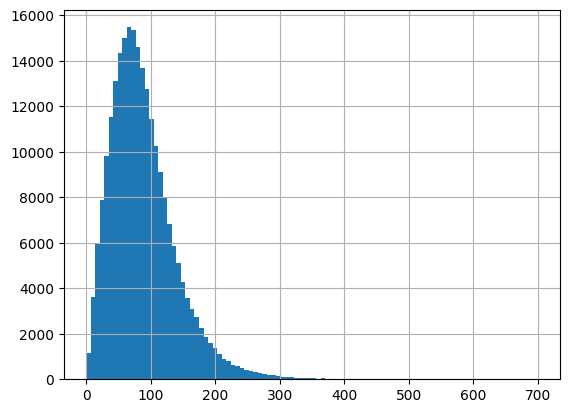

In [10]:
adata_cells_ini.obs['transcript_counts'].hist(bins=100)

<Axes: >

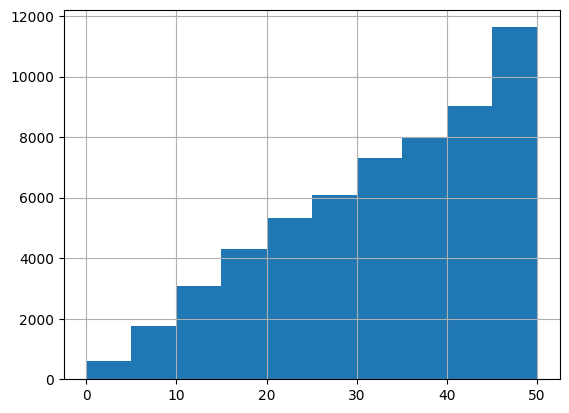

In [11]:
# in range 0-50
adata_cells_ini.obs['transcript_counts'].hist(range=(0,50))

In [12]:
print(f"Number of cells with less than 20 transcripts: {(adata_cells_ini.obs['transcript_counts']<20).sum()}")
print(f"Percentage of cells with less than 20 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<20).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 15 transcripts: {(adata_cells_ini.obs['transcript_counts']<15).sum()}")
print(f"Percentage of cells with less than 15 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<15).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number of cells with less than 10 transcripts: {(adata_cells_ini.obs['transcript_counts']<10).sum()}")
print(f"Percentage of cells with less than 10 transcripts: {round(((adata_cells_ini.obs['transcript_counts']<10).sum())/len(adata_cells_ini.obs)*100, 2)}%")
print('-----')
print(f"Number total of cells: {len(adata_cells_ini.obs)}")

Number of cells with less than 20 transcripts: 9781
Percentage of cells with less than 20 transcripts: 4.09%
-----
Number of cells with less than 15 transcripts: 5462
Percentage of cells with less than 15 transcripts: 2.28%
-----
Number of cells with less than 10 transcripts: 2381
Percentage of cells with less than 10 transcripts: 1.0%
-----
Number total of cells: 239271


In [13]:
adata_cells =  adata_cells_ini[adata_cells_ini.obs['transcript_counts']>10].copy()
print(len(adata_cells.obs))

236408


In [14]:
# Save the raw data
adata_cells.layers['count'] = adata_cells.X.copy()

In [15]:
# Normalize
sc.pp.normalize_total(adata_cells, target_sum=1e4)
sc.pp.log1p(adata_cells)
adata_cells.layers['log_norm'] = adata_cells.X.copy()

In [16]:
# Scale each gene to unit variance. Clip values exceeding standard deviation 10.
sc.pp.scale(adata_cells, max_value=10)

## 3. Principal component analysis

In [17]:
# Reduce the dimensionality of the data by running principal component analysis (PCA), which reveals the main axes of variation and denoises the data.
sc.tl.pca(adata_cells, svd_solver="arpack", use_highly_variable=False)

/Users/felicie-giraud-sauveur/miniforge3/envs/cluster/lib/python3.10/site-packages/scanpy/preprocessing/_pca.py:385: FutureWarning: Argument `use_highly_variable` is deprecated, consider using the mask argument. Use_highly_variable=True can be called through mask_var="highly_variable". Use_highly_variable=False can be called through mask_var=None
  warn(msg, FutureWarning)


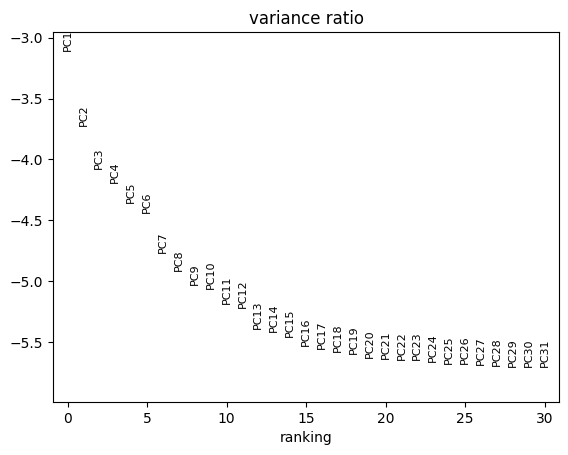

In [18]:
# Contribution of single PCs to the total variance in the data
# This gives us information about how many PCs we should consider in order to compute the neighborhood relations of cells, e.g. used in the clustering function  `sc.tl.louvain()` or tSNE `sc.tl.tsne()`
sc.pl.pca_variance_ratio(adata_cells, log=True)

In [19]:
adata_cells

AnnData object with n_obs × n_vars = 236408 × 377
    obs: 'cell_id', 'transcript_counts', 'control_probe_counts', 'control_codeword_counts', 'unassigned_codeword_counts', 'deprecated_codeword_counts', 'total_counts', 'cell_area', 'nucleus_area', 'region'
    var: 'gene_ids', 'feature_types', 'genome', 'mean', 'std'
    uns: 'spatialdata_attrs', 'log1p', 'pca'
    obsm: 'spatial', 'X_pca'
    varm: 'PCs'
    layers: 'count', 'log_norm'

In [20]:
# Restore X to be log norm counts
# /!\ ALL the following analysis will use the 'log_norm' layer as input /!\
dc.swap_layer(adata_cells, 'log_norm', X_layer_key=None, inplace=True)

## 4. The neighborhood graph + clustering

In [21]:
# Neighborhood graph of cells using the PCA representation of the data matrix
sc.pp.neighbors(adata_cells, n_neighbors=10, n_pcs=16, use_rep="X_pca", key_added='pca_n10_pcs16')
# Embedding the neighborhood graph using UMAP
sc.tl.umap(adata_cells, neighbors_key='pca_n10_pcs16')
# Leiden clustering directly clusters the neighborhood graph of cells
sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.4, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.4', neighbors_key='pca_n10_pcs16')
sc.tl.leiden(adata_cells, resolution=0.6, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.6', neighbors_key='pca_n10_pcs16')

/var/folders/ff/llzyqd_s78v1k8vywvjxp5_r0000gn/T/ipykernel_1265/1436083260.py:6: FutureWarning: In the future, the default backend for leiden will be igraph instead of leidenalg.

 To achieve the future defaults please pass: flavor="igraph" and n_iterations=2.  directed must also be False to work with igraph's implementation.
  sc.tl.leiden(adata_cells, resolution=0.2, random_state=0, n_iterations=2, directed=False, key_added='pca_n10_pcs16_leiden_res0.2', neighbors_key='pca_n10_pcs16')


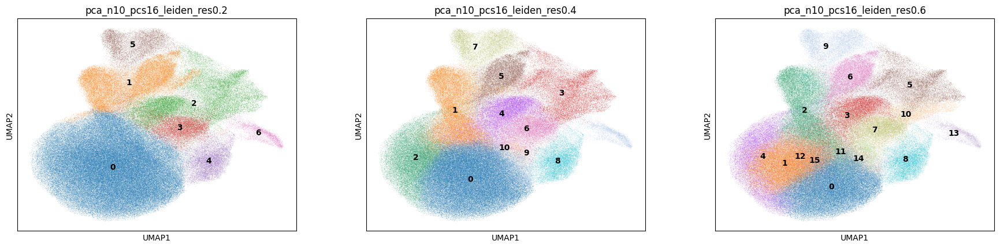

In [22]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16',
           color=['pca_n10_pcs16_leiden_res0.2', 'pca_n10_pcs16_leiden_res0.4', 'pca_n10_pcs16_leiden_res0.6'],
           ncols=3, legend_loc='on data')

In [23]:
# Number of clusters
adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].unique()

['3', '6', '0', '1', '2', ..., '7', '5', '10', '8', '9']
Length: 11
Categories (11, object): ['0', '1', '2', '3', ..., '7', '8', '9', '10']

In [24]:
# Refine resolution
adata_cells.obs['refine_res'] = 'att'

adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['0']), 'refine_res'] = '0'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['1']), 'refine_res'] = '1'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['2']), 'refine_res'] = '2'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['3']), 'refine_res'] = '3'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['4']), 'refine_res'] = '4'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['5']), 'refine_res'] = '5'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['6']), 'refine_res'] = '6'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['7']), 'refine_res'] = '7'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['8']), 'refine_res'] = '8'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['9']), 'refine_res'] = '9'
adata_cells.obs.loc[adata_cells.obs['pca_n10_pcs16_leiden_res0.4'].isin(['10']), 'refine_res'] = '10'

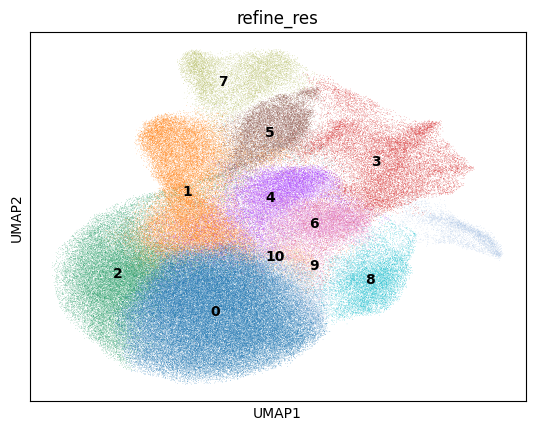

In [25]:
# Plot the clusters
sc.pl.umap(adata_cells, neighbors_key='pca_n10_pcs16', color=['refine_res'], legend_loc='on data')

## 5. Name clusters

**To go from specific gene marker to cell type: http://xteam.xbio.top/CellMarker/search.jsp?cellMarkerSpeciesType=Human&cellMarker=CD5L**

In [26]:
clustering_label = 'refine_res'

In [27]:
merged_df = pd.merge(adata_cells.obs[['cell_id', 'refine_res']].copy(), adata_nuclei.obs[['cell_id', 'label1', 'label2', 'label3']].copy(), on='cell_id', how='outer')

for col in ['label1', 'label2', 'label3']:
    if merged_df[col].dtype.name == 'category':  # Check if already categorical
        merged_df[col] = merged_df[col].cat.add_categories('NA')  # Add 'NA' as a category
merged_df[['label1', 'label2', 'label3']] = merged_df[['label1', 'label2', 'label3']].fillna('NA')

merged_df['label_combined'] = merged_df[['label1', 'label2', 'label3']].apply(lambda x: '&'.join(x.astype(str)), axis=1)

def compare_with_nuclei(merged_df, cluster_id):

    df_filtered = merged_df[merged_df['refine_res'] == cluster_id]
    label_counts = df_filtered['label_combined'].value_counts(normalize=True)
    top_5 = label_counts.head(5)

    top_5_df = top_5.reset_index()
    top_5_df.columns = ['label_combined', 'percentage']
    
    labels_split = top_5_df['label_combined'].str.split('&', expand=True)
    labels_split.columns = ['label1', 'label2', 'label3']

    top_5_df['percentage'] = (top_5_df['percentage'] * 100).round(1).astype(str)

    top_5_df_final = pd.concat([labels_split, top_5_df['percentage']], axis=1)
    
    return top_5_df_final

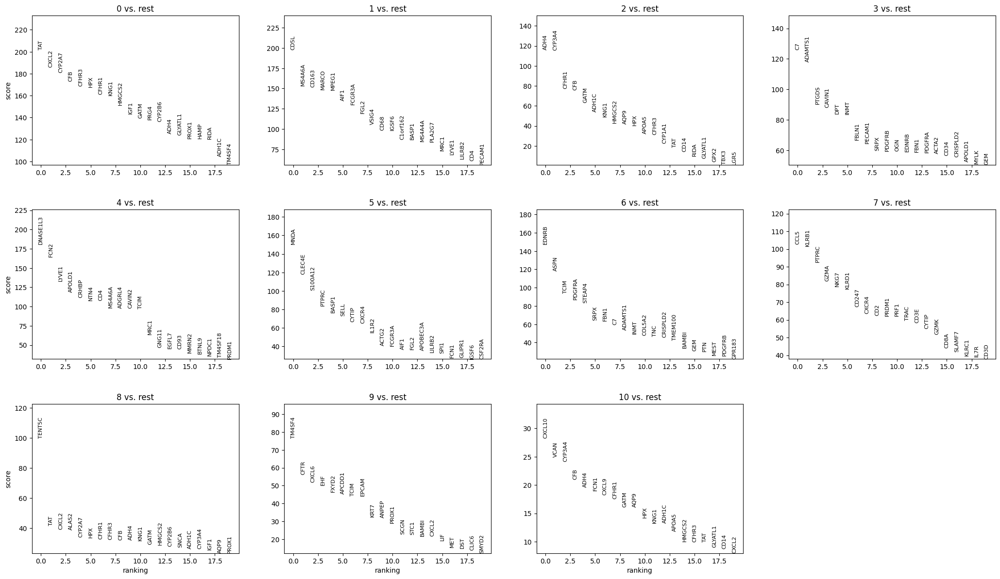

In [28]:
# Wilcoxon rank-sum (Mann-Whitney-U) test. 
# You might also consider much more powerful differential testing packages like MAST, limma, DESeq2 and, for python, the recent diffxpy.
sc.tl.rank_genes_groups(adata_cells, clustering_label, method="wilcoxon", corr_method="benjamini-hochberg", key_added="rank_genes_"+clustering_label)
sc.pl.rank_genes_groups(adata_cells, n_genes=20, sharey=False, key="rank_genes_"+clustering_label)

In [29]:
# The top ranked genes per cluster
top_ranked_genes = pd.DataFrame(adata_cells.uns["rank_genes_"+clustering_label]["names"]).iloc[:7, :]
list_genes = pd.concat([top_ranked_genes[col] for col in top_ranked_genes], ignore_index=True).tolist()

In [30]:
adata_cells.obs['label1'] = 'att'
adata_cells.obs['label2'] = 'att'
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

### 5.1. Cluster 0

In [42]:
cluster_id = '0'

In [32]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Hepatocyte,normal_cell,84.3
1,NA,NA,NA,11.3
2,ToRemove,ToRemove,normal_cell,2.8
3,Epithelial,Cholangiocytes,normal_cell,0.9
4,Fibroblast,Fibroblast,normal_cell,0.4


In [33]:
top_ranked_genes[cluster_id]

0       TAT
1     CXCL2
2    CYP2A7
3       CFB
4     CFHR3
5       HPX
6     CFHR1
Name: 0, dtype: object

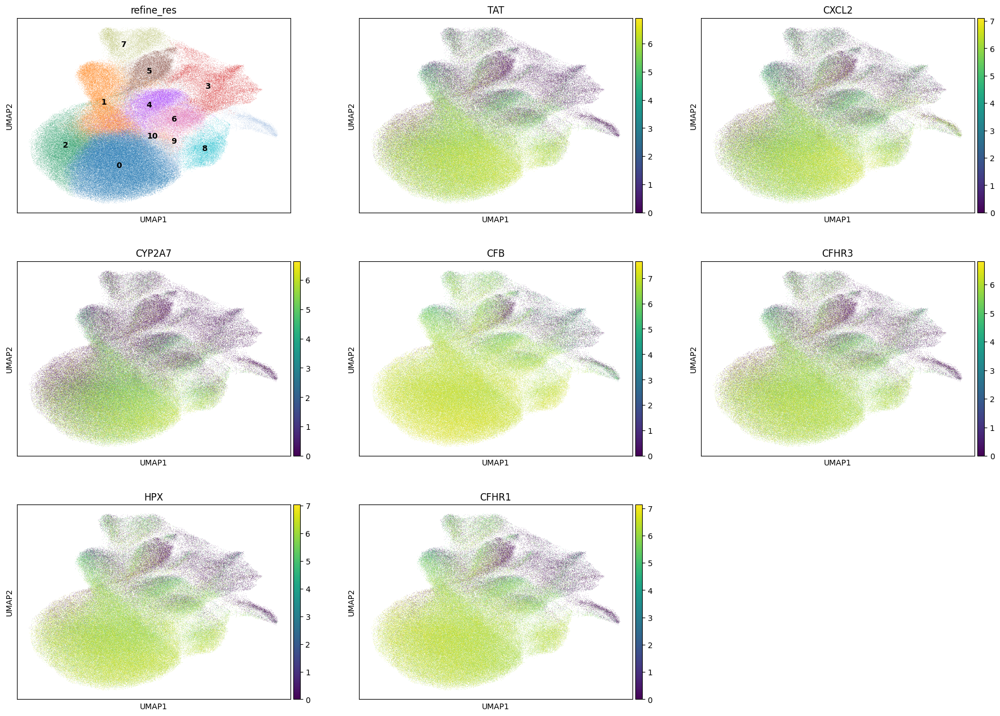

In [34]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [35]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 0: 83253
Percentage of cells in cluster 0: 35.2


In [43]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Hepatocyte'

### 5.2. Cluster 1

In [44]:
cluster_id = '1'

In [38]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Hepatocyte,normal_cell,35.5
1,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,33.4
2,NA,NA,NA,27.1
3,ToRemove,ToRemove,normal_cell,1.1
4,Endothelial,Endothelial,normal_cell,1.1


In [39]:
top_ranked_genes[cluster_id]

0      CD5L
1    MS4A6A
2     CD163
3     MARCO
4     MPEG1
5      AIF1
6    FCGR3A
Name: 1, dtype: object

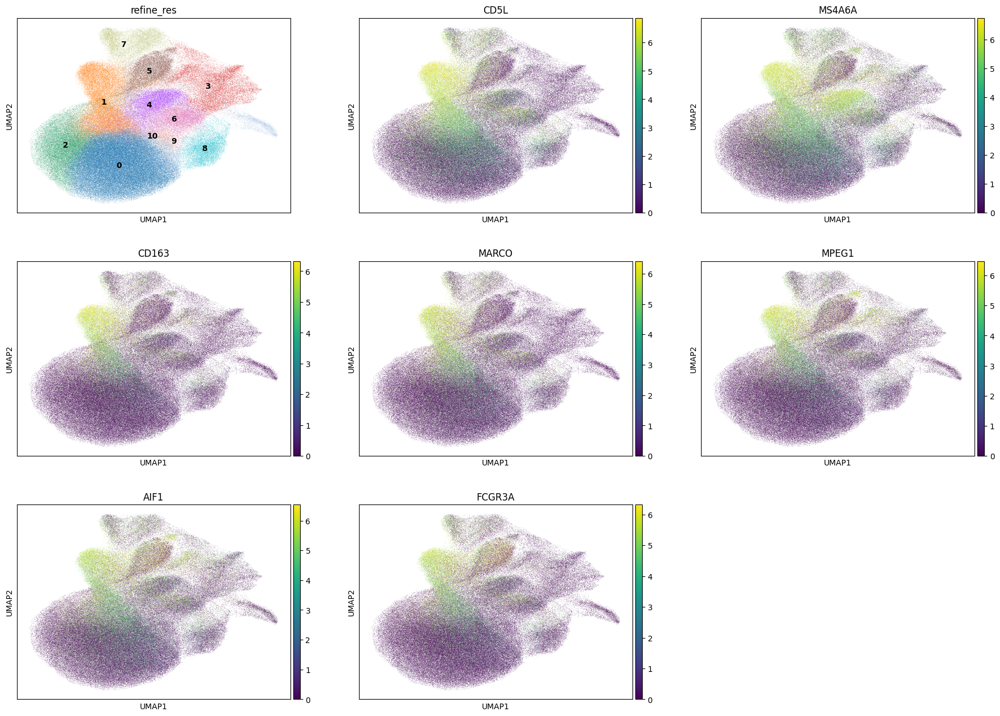

In [40]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [41]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 1: 29913
Percentage of cells in cluster 1: 12.7


In [45]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Kupffer_cell'

### 5.3. Cluster 2

In [46]:
cluster_id = '2'

In [47]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,52.9
1,Epithelial,Hepatocyte,normal_cell,44.0
2,Epithelial,Cholangiocytes,normal_cell,1.3
3,ToRemove,ToRemove,normal_cell,0.9
4,Fibroblast,Fibroblast,normal_cell,0.5


In [48]:
top_ranked_genes[cluster_id]

0      ADH4
1    CYP3A4
2     CFHR1
3       CFB
4      GATM
5     ADH1C
6      KNG1
Name: 2, dtype: object

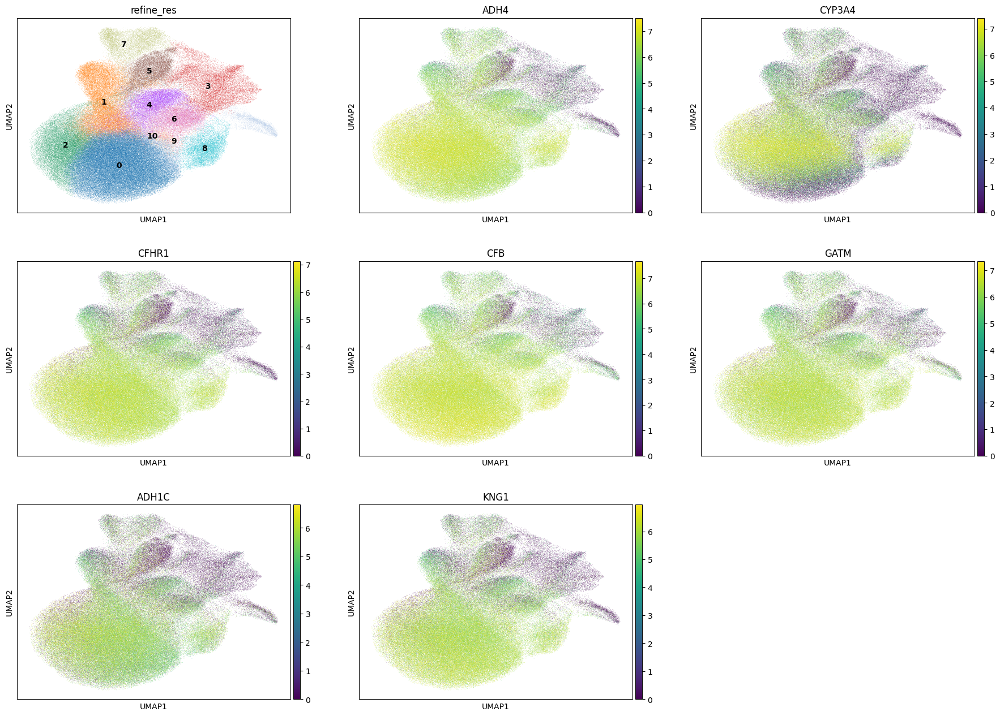

In [49]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [50]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 2: 27953
Percentage of cells in cluster 2: 11.8


In [51]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Hepatocyte'

### 5.4. Cluster 3

In [52]:
cluster_id = '3'

In [53]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,Fibroblast,normal_cell,27.9
1,NA,NA,NA,24.2
2,Endothelial,Endothelial,normal_cell,21.3
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,14.9
4,T/NK,T/NK,normal_cell,7.9


In [54]:
top_ranked_genes[cluster_id]

0         C7
1    ADAMTS1
2      PTGDS
3     CAVIN1
4        DPT
5       INMT
6      FBLN1
Name: 3, dtype: object

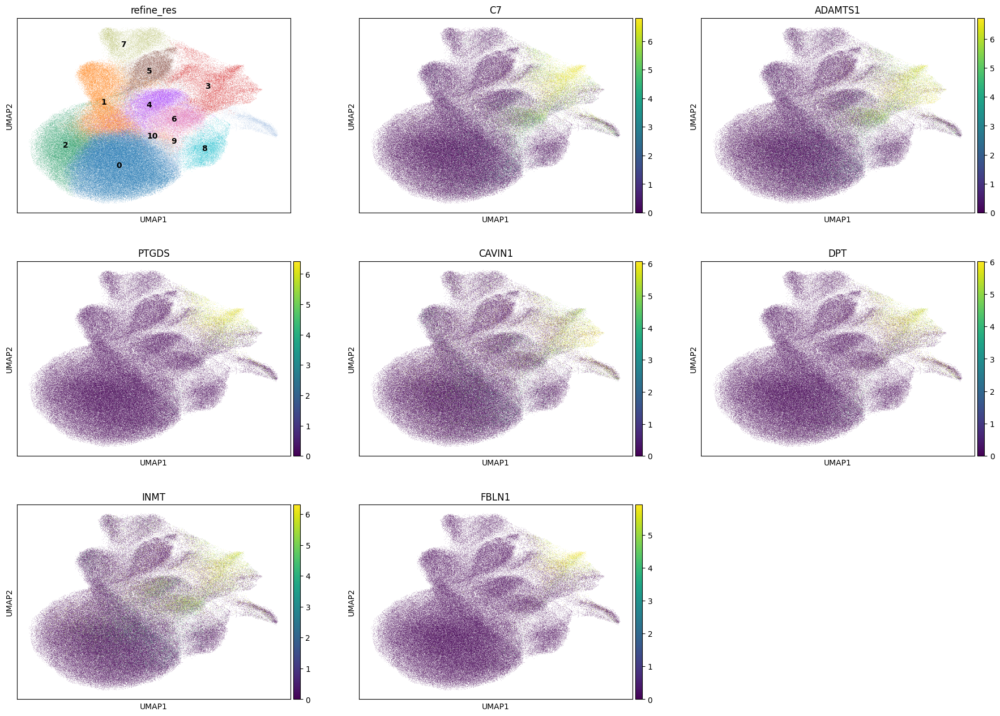

In [55]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [56]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 3: 19971
Percentage of cells in cluster 3: 8.4


In [57]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.5. Cluster 4

In [58]:
cluster_id = '4'

In [59]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Endothelial,Endothelial,normal_cell,65.8
1,NA,NA,NA,19.0
2,Epithelial,Hepatocyte,normal_cell,13.2
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,0.7
4,Fibroblast,Fibroblast,normal_cell,0.6


In [60]:
top_ranked_genes[cluster_id]

0    DNASE1L3
1        FCN2
2       LYVE1
3      APOLD1
4       CRHBP
5        NTN4
6         CD4
Name: 4, dtype: object

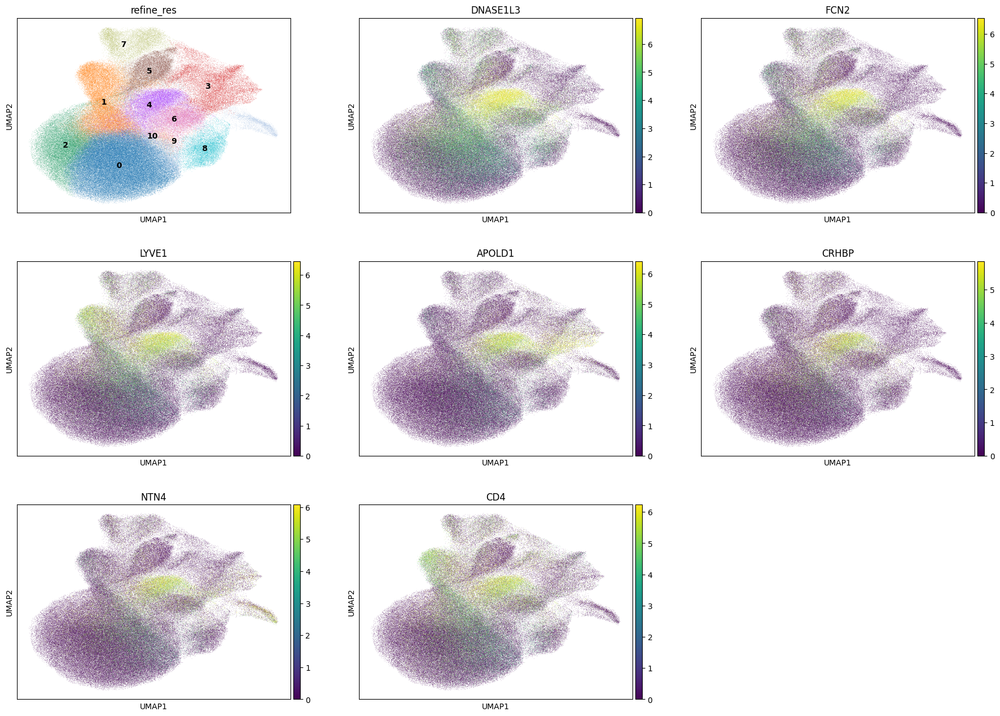

In [61]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [62]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 4: 16172
Percentage of cells in cluster 4: 6.8


In [63]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Endothelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Liver_sinusoidal_endothelial_cell'

### 5.6. Cluster 5

In [64]:
cluster_id = '5'

In [65]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,NA,NA,NA,47.9
1,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,47.2
2,Epithelial,Hepatocyte,normal_cell,3.3
3,Endothelial,Endothelial,normal_cell,0.5
4,Fibroblast,Fibroblast,normal_cell,0.4


In [66]:
top_ranked_genes[cluster_id]

0       MNDA
1     CLEC4E
2    S100A12
3      PTPRC
4      BASP1
5       SELL
6      CYTIP
Name: 5, dtype: object

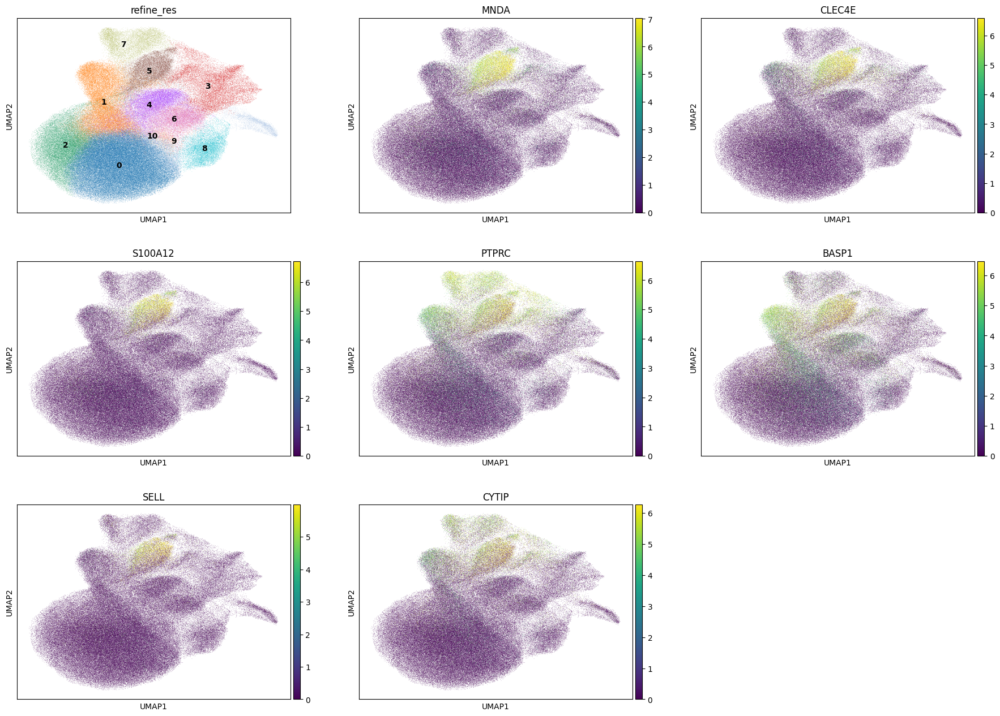

In [67]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [68]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 5: 13560
Percentage of cells in cluster 5: 5.7


In [69]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Monocyte/Macrophage'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Monocyte/Macrophage'

### 5.7. Cluster 6

In [70]:
cluster_id = '6'

In [71]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Fibroblast,Fibroblast,normal_cell,58.7
1,NA,NA,NA,26.3
2,Epithelial,Hepatocyte,normal_cell,10.9
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,2.0
4,Endothelial,Endothelial,normal_cell,1.3


In [72]:
top_ranked_genes[cluster_id]

0     EDNRB
1      ASPN
2      TCIM
3    PDGFRA
4    STEAP4
5      SRPX
6      FBN1
Name: 6, dtype: object

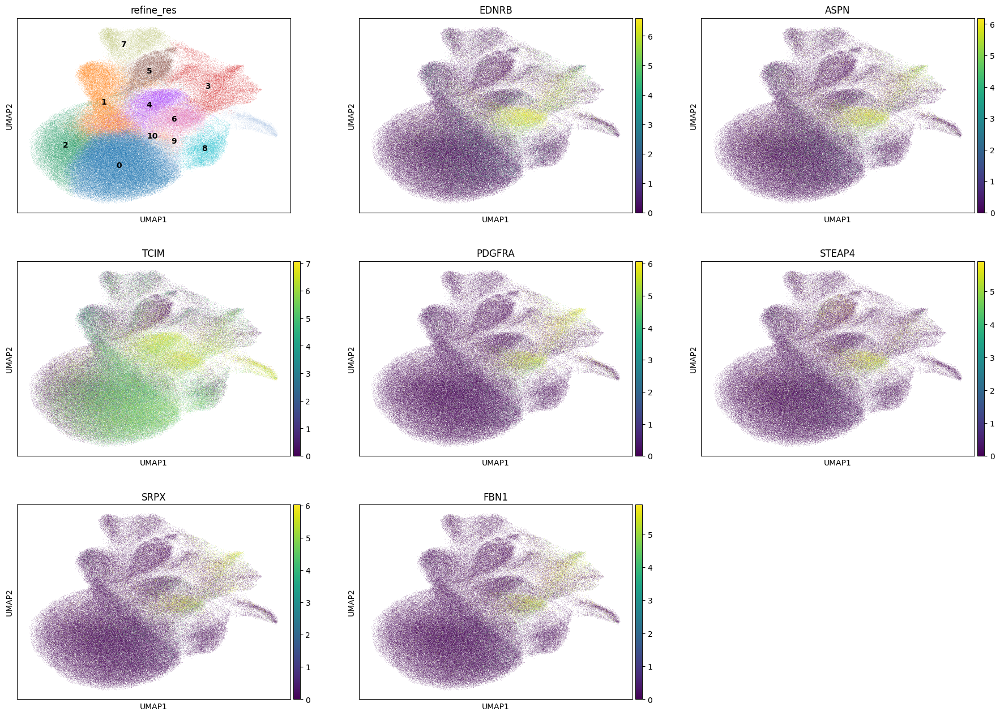

In [73]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [74]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 6: 12787
Percentage of cells in cluster 6: 5.4


In [75]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Fibroblast'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Fibroblast'

### 5.8. Cluster 7

In [76]:
cluster_id = '7'

In [77]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,T/NK,T/NK,normal_cell,66.4
1,NA,NA,NA,21.2
2,Epithelial,Hepatocyte,normal_cell,8.9
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.7
4,ToRemove,ToRemove,normal_cell,0.8


In [78]:
top_ranked_genes[cluster_id]

0     CCL5
1    KLRB1
2    PTPRC
3     GZMA
4     NKG7
5    KLRD1
6    CD247
Name: 7, dtype: object

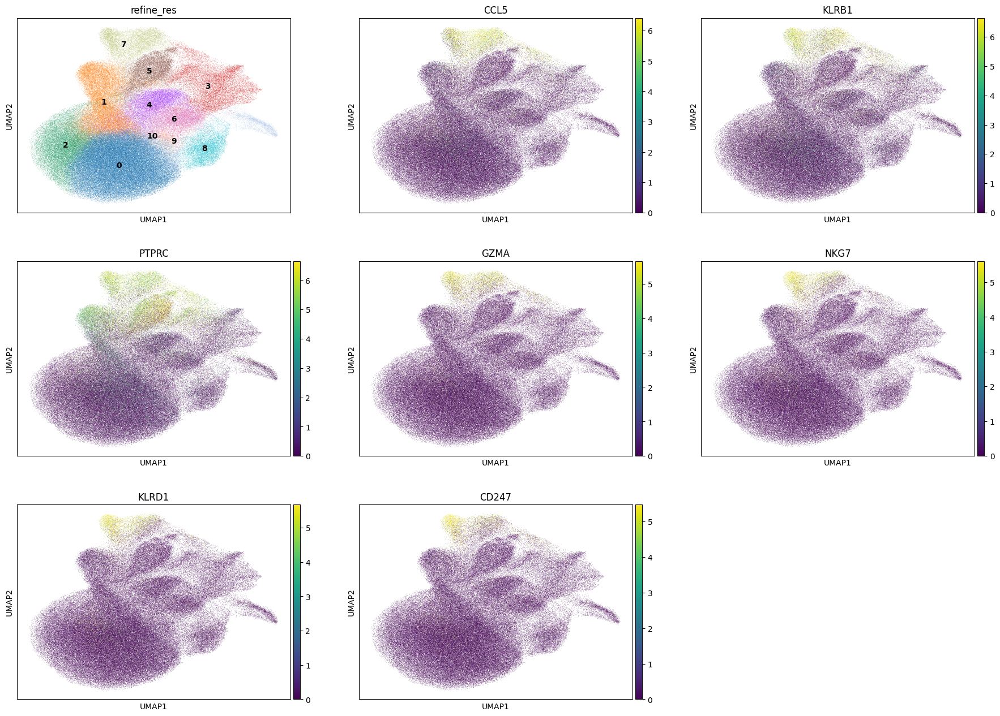

In [79]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [80]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 7: 10893
Percentage of cells in cluster 7: 4.6


In [81]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'T/NK'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'T/NK'

### 5.9. Cluster 8

In [82]:
cluster_id = '8'

In [83]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Hepatocyte,normal_cell,74.5
1,NA,NA,NA,16.5
2,ToRemove,ToRemove,normal_cell,3.1
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,2.1
4,Endothelial,Endothelial,normal_cell,1.7


In [84]:
top_ranked_genes[cluster_id]

0    TENT5C
1       TAT
2     CXCL2
3     ALAS2
4    CYP2A7
5       HPX
6     CFHR1
Name: 8, dtype: object

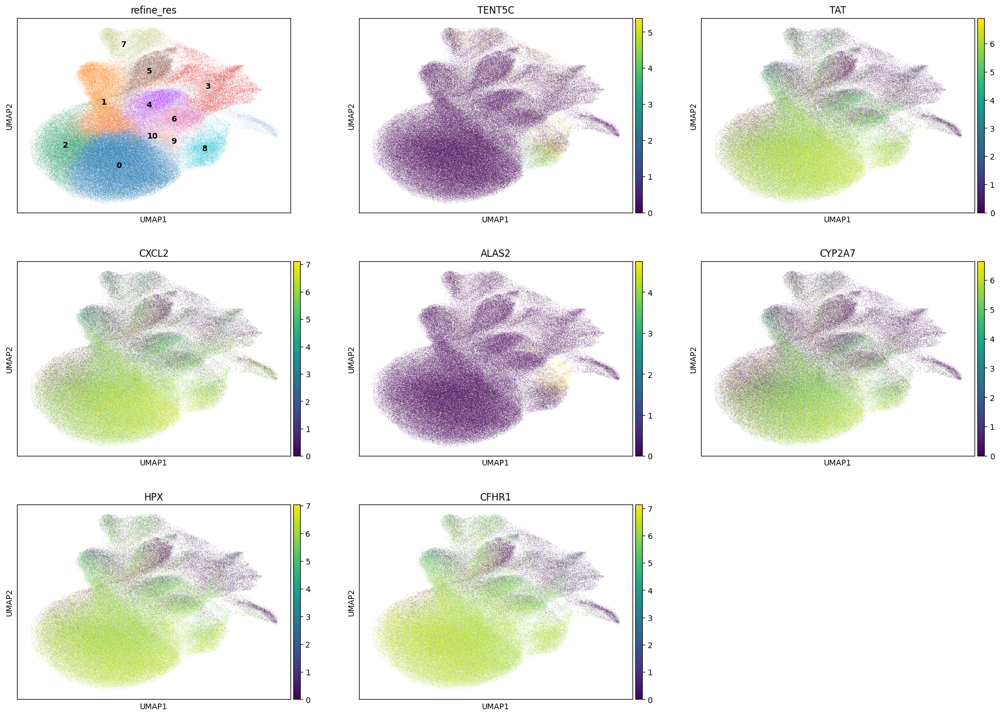

In [85]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [86]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 8: 10145
Percentage of cells in cluster 8: 4.3


In [87]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Hepatocyte'

### 5.10. Cluster 9

In [88]:
cluster_id = '9'

In [89]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Hepatocyte,normal_cell,43.4
1,Epithelial,Cholangiocytes,normal_cell,38.5
2,NA,NA,NA,13.2
3,ToRemove,ToRemove,normal_cell,2.1
4,Fibroblast,Fibroblast,normal_cell,1.2


In [90]:
top_ranked_genes[cluster_id]

0    TM4SF4
1      CFTR
2     CXCL6
3       EHF
4     FXYD2
5    APCDD1
6      TCIM
Name: 9, dtype: object

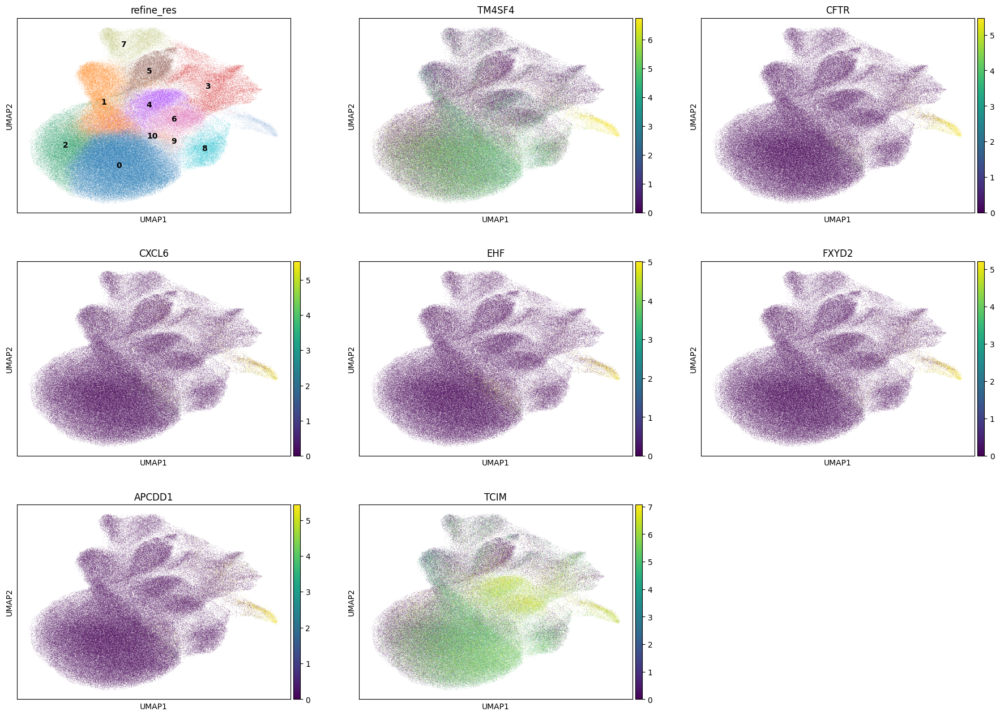

In [91]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [92]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 9: 9114
Percentage of cells in cluster 9: 3.9


In [93]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Cholangiocyte'

### 5.11. Cluster 10

In [94]:
cluster_id = '10'

In [95]:
compare_with_nuclei(merged_df, cluster_id)

,label1,label2,label3,percentage
0,Epithelial,Hepatocyte,normal_cell,50.9
1,NA,NA,NA,27.0
2,ToRemove,ToRemove,normal_cell,18.4
3,Monocyte/Macrophage,Monocyte/Macrophage,normal_cell,1.3
4,Epithelial,Cholangiocytes,normal_cell,1.1


In [96]:
top_ranked_genes[cluster_id]

0    CXCL10
1      VCAN
2    CYP3A4
3       CFB
4      ADH4
5      FCN1
6     CXCL9
Name: 10, dtype: object

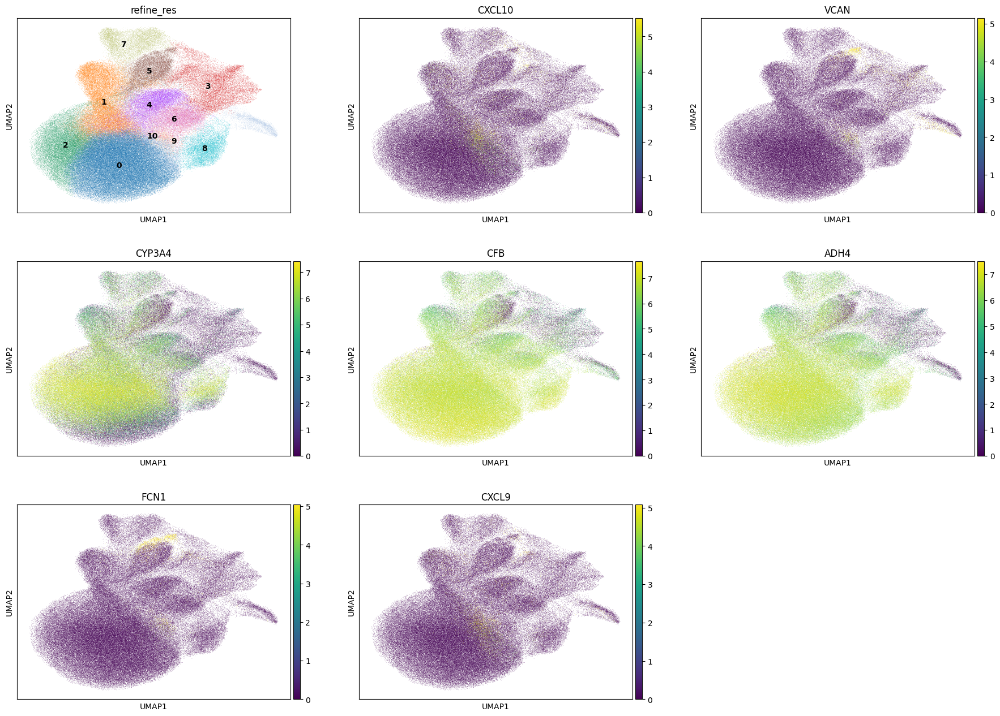

In [97]:
sc.pl.umap(adata_cells, color=[clustering_label]+list_genes[int(cluster_id)*7:int(cluster_id)*7+7], vmax="p99", vmin=0, ncols=3, legend_loc='on data')

In [98]:
print(f"Number of cells in cluster {cluster_id}: {len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id])}")
print(f"Percentage of cells in cluster {cluster_id}: {round(len(adata_cells.obs[clustering_label][adata_cells.obs[clustering_label]==cluster_id]) / len(adata_cells.obs[clustering_label]) * 100, 1)}")

Number of cells in cluster 10: 2647
Percentage of cells in cluster 10: 1.1


In [99]:
adata_cells.obs['label1'] = adata_cells.obs['label1'].astype('str')
adata_cells.obs['label2'] = adata_cells.obs['label2'].astype('str')

adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label1'] = 'Epithelial'
adata_cells.obs.loc[adata_cells.obs['refine_res'] == cluster_id, 'label2'] = 'Hepatocyte'

## 6. Cancer cells

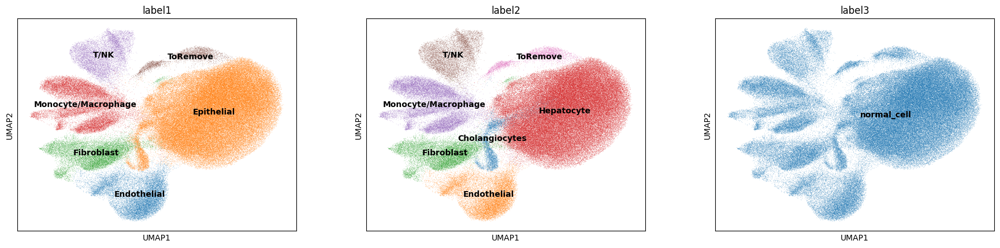

In [102]:
sc.pl.umap(adata_nuclei, color=['label1', 'label2', 'label3'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

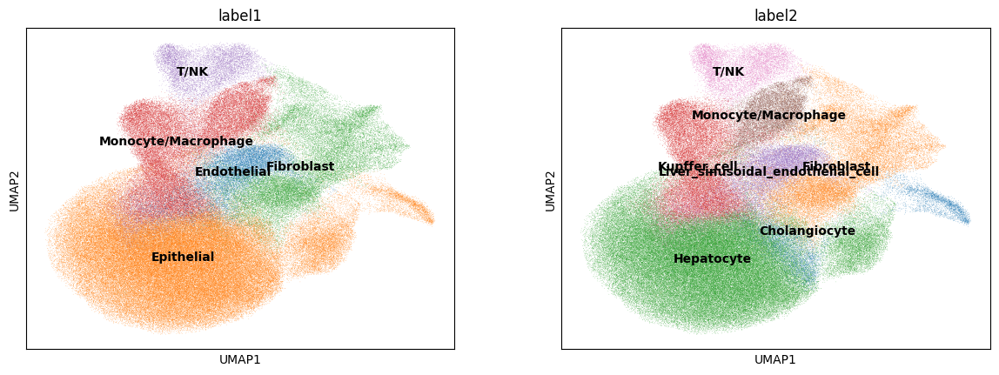

In [103]:
sc.pl.umap(adata_cells, color=['label1', 'label2'], vmax="p99", vmin=0, ncols=4, legend_loc='on data')

In [104]:
# Cancer cells
adata_cells.obs['label3'] = 'normal_cell'

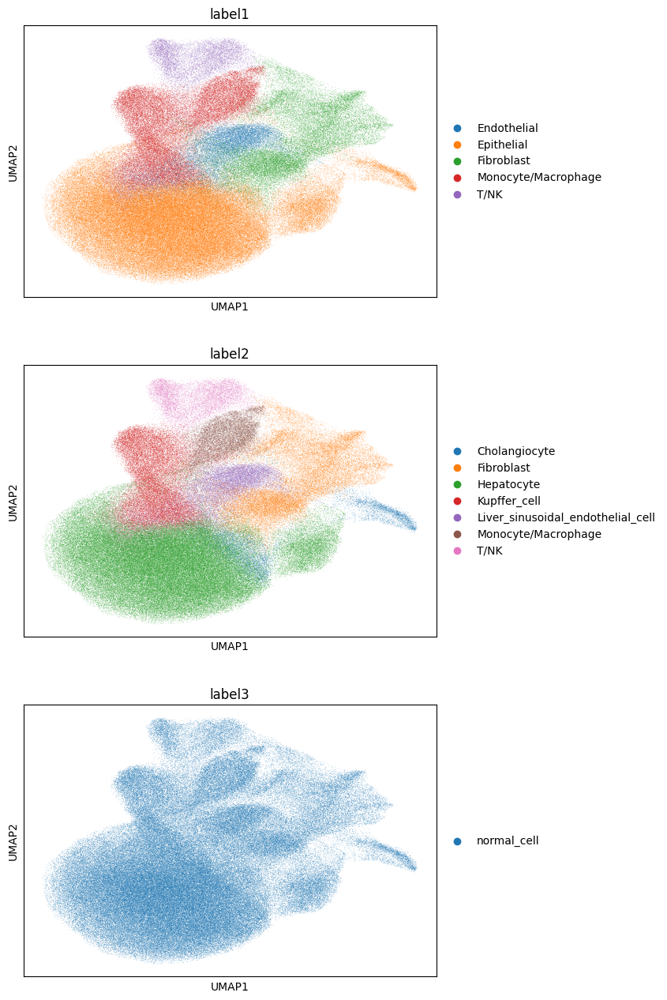

In [105]:
sc.pl.umap(adata_cells, color=['label1', 'label2', 'label3'], ncols=1)

## 7. Save

In [106]:
adata_cells.obs

,cell_id,transcript_counts,control_probe_counts,control_codeword_counts,unassigned_codeword_counts,deprecated_codeword_counts,total_counts,cell_area,nucleus_area,region,pca_n10_pcs16_leiden_res0.2,pca_n10_pcs16_leiden_res0.4,pca_n10_pcs16_leiden_res0.6,refine_res,label1,label2,label3
0,aaaaaaaa-1,133,0,0,0,0,133,416.295484,15.127344,cell_labels,2,3,5,3,Fibroblast,Fibroblast,normal_cell
2,aaaaaaac-1,99,0,0,0,0,99,454.994392,17.340001,cell_labels,2,3,5,3,Fibroblast,Fibroblast,normal_cell
3,aaaaaaad-1,140,0,0,0,0,140,346.077513,14.946719,cell_labels,2,3,5,3,Fibroblast,Fibroblast,normal_cell
4,aaaaaaae-1,61,0,0,0,0,61,118.219067,15.533751,cell_labels,2,3,5,3,Fibroblast,Fibroblast,normal_cell
5,aaaaaaaf-1,81,0,0,0,0,81,200.087351,15.895001,cell_labels,2,3,5,3,Fibroblast,Fibroblast,normal_cell
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
239264,aaadkgka-1,28,0,0,0,0,28,72.295159,7.360469,cell_labels,2,3,5,3,Fibroblast,Fibroblast,normal_cell
239265,aaadkgkb-1,133,0,0,0,0,133,318.848293,19.236563,cell_labels,2,3,5,3,Fibroblast,Fibroblast,normal_cell
239266,aaadkgkc-1,68,0,0,0,0,68,65.702346,17.023907,cell_labels,2,3,5,3,Fibroblast,Fibroblast,normal_cell
239267,aaadkgkd-1,45,0,0,0,0,45,41.950158,16.662657,cell_labels,2,3,5,3,Fibroblast,Fibroblast,normal_cell


In [107]:
adata_cells.write_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")
# adata_cells = sc.read_h5ad(f"/Volumes/One Touch/MICS/data_HE2CellType/CT_DS/adata_annots_cells/adata_annots_cells_{slide_id}.h5ad")